# Energy Preserving Operator Inference Optimization Example using Periodic BC Burger's Equation

In this notebook, we conduct the numerical experiment for the energy-preserving Operator Inference (ep-OpInf) for both the hard equality constraint and soft inequality constraint.

## Packages

In [1]:
using CSV
using DataFrames
using FileIO
using JLD2
using LaTeXStrings
using LinearAlgebra
using NaNStatistics
using Plots
using ProgressMeter
using Random
using SparseArrays
using Statistics
using Tables
;

## Initial Setup

In [2]:
include("../src/model/Burgers.jl")
include("../src/LiftAndLearn.jl")
const LnL = LiftAndLearn
;

In [3]:
# First order Burger's equation setup
burger = Burgers(
    [0.0, 1.0], [0.0, 1.0], [0.03, 0.15],
    2^(-7), 1e-4, 1, "periodic"
)
;

## Energy Preserving Constraint Optimization

In [4]:
# Create file name to save data
filename = "data/epOpInf_periodic_data.jld2"
;

### Important Parameters

In [5]:
# Minimum and maximum dimensions
rmin = 1
rmax = 10

burger_system = LnL.sys_struct(
    is_lin=true,
    is_quad=true,
)
burger_vars = LnL.vars(
    N=1,
)
burger_data = LnL.data(
    Δt=1e-4,
    DS=100,
)
burger_optim = LnL.opt_settings(
    verbose=true,
    initial_guess=false,
    max_iter=500,
    reproject=false,
    SIGE=true,
)

options = LnL.LS_options(
    system=burger_system,
    vars=burger_vars,
    data=burger_data,
    optim=burger_optim,
)

# Downsampling rate
DS = burger_data.DS

# Down-sampled dimension of the time data
Tdim_ds = size(1:DS:burger.Tdim, 1)  # downsampled time dimension
;

#### Run below to change to periodic boundary condition
- Initial condition to: sinusoidal wave
    - with three parameters: amplitude ($A$), frequency ($a$), and phase ($b$)
- Zero boundary condition

In [8]:
# Parameters of the initial condition
AMP = [0.5, 1.0, 1.5]
FREQ = [1, 2, 3]
PHASE = [-1, 0, 1]
num_ic_params = Int(length(AMP) * length(FREQ) * length(PHASE))

# Parameterized function for the initial condition
init_wave = (A,a,b) -> A .* sin.(2 * pi * a * burger.x .+ b) 
;  

### Generate Training Data

In [9]:
# Store values
Xtr = Vector{Matrix{Float64}}(undef, burger.Pdim)  # training state data 10x1
Rtr = Vector{Matrix{Float64}}(undef, burger.Pdim)  # training derivative data 10x1
Xtr_all = Matrix{Matrix{Float64}}(undef, burger.Pdim, num_ic_params)  # all training data 10x27
Vrmax = Vector{Matrix{Float64}}(undef, burger.Pdim)  # POD basis 10x1
op_fom_tr = Vector{LnL.operators}(undef, burger.Pdim)  # FOM operators 10x1

@info "Generate the FOM system matrices and training data."
@showprogress for i in 1:length(burger.μs)
    μ = burger.μs[i]

    # Generate the FOM system matrices (ONLY DEPENDS ON μ)
    A, F = burger.generateEPmatrix(burger, μ)
    op_fom_tr[i] = LnL.operators(A=A, F=F)

    # Store the training data 
    Xall = Vector{Matrix{Float64}}(undef, num_ic_params)
    Xdotall = Vector{Matrix{Float64}}(undef, num_ic_params)
    
    # Generate the data for all combinations of the initial condition parameters
    ct = 1  # set/reset counter
    for amp in AMP, freq in FREQ, phase in PHASE
        states = burger.semiImplicitEuler(A, F, burger.t, init_wave(amp, freq, phase))
        Xtr_all[i] = states
        
        tmp = states[:, 2:end]
        Xall[ct] = tmp[:, 1:DS:end]  # downsample data
        tmp = (states[:, 2:end] - states[:, 1:end-1]) / burger.Δt
        Xdotall[ct] = tmp[:, 1:DS:end]  # downsample data

        ct += 1  # increment counter
    end
    # Combine all initial condition data to form on big training data matrix
    Xtr[i] = reduce(hcat, Xall) 
    Rtr[i] = reduce(hcat, Xdotall)
    
    # Compute the POD basis from the training data
    tmp = svd(Xtr[i])
    Vrmax[i] = tmp.U[:, 1:rmax]
end

Data = Dict("Xtr" => Xtr, "Rtr" => Rtr, "Vrmax" => Vrmax, 
        "op_fom_tr" => op_fom_tr, "Xtr_all" => Xtr_all)
@save filename Data

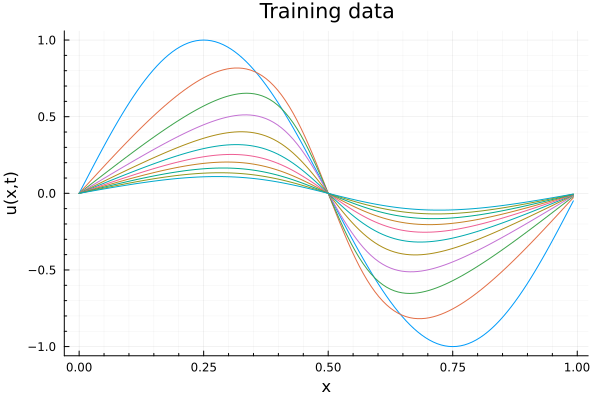

In [8]:
p1 = plot()
for i in 1:1000:burger.Tdim
    plot!(p1, burger.x, Xtr_all[1,1][:, i])
end
plot!(p1, xlabel="x", ylabel="u(x,t)", title="Training data", grid=true,
    minorgrid=true, legend=false)

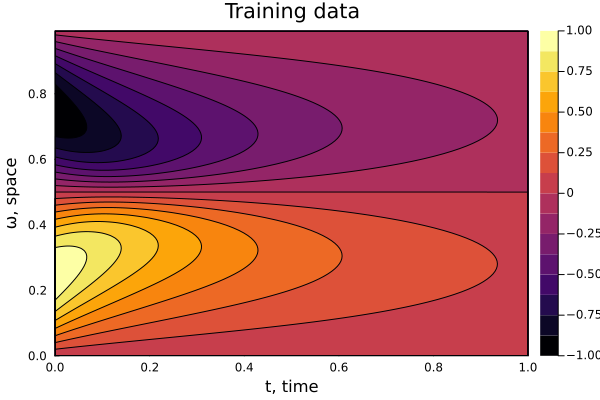

In [9]:
plot(contour(burger.t, burger.x, Xtr_all[1,1], fill=true), xlabel="t, time", ylabel="ω, space", zlabel="u(x,t)", title="Training data")

### Obtain OpInf Least Square Solution

In [10]:
@info "Compute the Least Squares solution."

options = LnL.LS_options(
    system=burger_system,
    vars=burger_vars,
    data=burger_data,
    optim=burger_optim,
    pinv_tol = 1e-12,          # tolerance for pseudo-inverse
)

# Store values
op_LS = Array{LnL.operators}(undef, burger.Pdim)

# Load the data dictionary
if !(@isdefined Data)
    @info "Loading data from epOpInf_periodic_data.jld2"
    if !isfile(filename)
        error("Run the cell above to generate the data first!")
    end
    Data = load(filename)
    Xtr = Data["Xtr"]
    Rtr = Data["Rtr"]
    Vrmax = Data["Vrmax"]
    @info "Data loaded."
end

@showprogress for i in 1:length(burger.μs)
    op_LS[i] = LnL.inferOp(Xtr[i], zeros(1,1), zeros(1,1), Vrmax[i], Vrmax[i]' * Rtr[i], options)
end

# Save to data
Data["op_LS"] = op_LS
save(filename, Data)

┌ Info: Compute the Least Squares solution.
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:1


┌ Warning: Rank difficient, rank = 20, tol = 7.568694771210641e-7.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\learn.jl:89
┌ Warning: Rank difficient, rank = 20, tol = 4.4207192468237856e-7.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\learn.jl:89


Progress:  20%|█████████                                |  ETA: 0:00:21

┌ Warning: Rank difficient, rank = 20, tol = 3.4820346227783916e-7.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\learn.jl:89


┌ Warning: Rank difficient, rank = 19, tol = 6.868547543368395e-7.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\learn.jl:89
Progress:  40%|█████████████████                        |  ETA: 0:00:08

┌ Warning: Rank difficient, rank = 19, tol = 6.689574762180085e-7.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\learn.jl:89
┌ Warning: Rank difficient, rank = 19, tol = 5.962149368690742e-7.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\learn.jl:89


Progress:  60%|█████████████████████████                |  ETA: 0:00:04

┌ Warning: Rank difficient, rank = 19, tol = 4.4381137264187543e-7.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\learn.jl:89


┌ Warning: Rank difficient, rank = 19, tol = 3.5727513393792e-7.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\learn.jl:89
Progress:  80%|█████████████████████████████████        |  ETA: 0:00:01

┌ Warning: Rank difficient, rank = 19, tol = 3.187488058284047e-7.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\learn.jl:89


┌ Warning: Rank difficient, rank = 18, tol = 9.312470037038978e-7.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\learn.jl:89
Progress: 100%|█████████████████████████████████████████| Time: 0:00:05


### Obtain intrusive operators 

In [11]:
@info "Compute the intrusive model"

# Store values
op_int = Array{LnL.operators}(undef, burger.Pdim)

# Load the data dictionary
if !(@isdefined Data)
    @info "Loading data from epOpInf_periodic_data.jld2"
    if !isfile(filename)
        error("Run the cell above to generate the data first!")
    end
    Data = load(filename)
    Vrmax = Data["Vrmax"]
    op_fom_tr = Data["op_fom_tr"]
    @info "Data loaded."
end

for i in 1:length(burger.μs)
    # Compute the values for the intrusive model from the basis of the training data
    op_int[i] = LnL.intrusiveMR(op_fom_tr[i], Vrmax[i], options)
    @info "Loop $(i) out of 10 completed..."
end

# Save to data
Data["op_int"] = op_int
save(filename, Data)

┌ Info: Compute the intrusive model
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:1


┌ Info: Loop 1 out of 10 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:21
┌ Info: Loop 2 out of 10 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:21
┌ Info: Loop 3 out of 10 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:21
┌ Info: Loop 4 out of 10 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:21
┌ Info: Loop 5 out of 10 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:21
┌ Info: Loop 6 out of 10 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:21
┌ Info: Loop 7 out of 10 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:21
┌ Info: Loop 8 out of 10 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.i

┌ Info: Loop 9 out of 10 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:21
┌ Info: Loop 10 out of 10 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:21


### Obtain operators for EPHEC-OpInf

In [12]:
@info "Compute the EPHEC OpInf."

options = LnL.EPHEC_options(
    system=burger_system,
    vars=burger_vars,
    data=burger_data,
    optim=burger_optim,
)

# Store values
op_ephec_opinf = Array{LnL.operators}(undef, burger.Pdim)

# Load the data dictionary
if !(@isdefined Data)
    @info "Loading data from data file..."
    if !isfile(filename)
        error("Run the cell above to generate the data first!")
    end
    Data = load(filename)
    Xtr = Data["Xtr"]
    Rtr = Data["Rtr"]
    Vrmax = Data["Vrmax"]
    op_int = Data["op_int"]
    op_LS = Data["op_LS"]
    @info "Data loaded."
end

@info "Compute the ephec-OpInf operators for test $(test)"
for i in 1:length(burger.μs)
    if test == 1
        op_ephec_opinf[i] = LnL.inferOp(Xtr[i], zeros(1,1), zeros(1,1), Vrmax[i], Vrmax[i]' * Rtr[i], options, op_int[i])
    elseif test == 2
        op_ephec_opinf[i] = LnL.inferOp(Xtr[i], zeros(1,1), zeros(1,1), Vrmax[i], Vrmax[i]' * Rtr[i], options, op_LS[i])
    elseif test == 3
        op_tmp = LnL.operators()
        for j in rmin:rmax
            if j == rmin
                options.optim.initial_guess = false
                op_tmp = LnL.inferOp(Xtr[i], zeros(1,1), zeros(1,1), Vrmax[i][:,1:j], Vrmax[i][:,1:j]' * Rtr[i], options)
            else
                options.optim.initial_guess = true
                op_tmp = LnL.inferOp(Xtr[i], zeros(1,1), zeros(1,1), Vrmax[i][:,1:j], Vrmax[i][:,1:j]' * Rtr[i], options, op_tmp)
            end

            if j != rmax
                op_tmp.A = [op_tmp.A zeros(j, 1); zeros(1, j+1)]
                op_tmp.F = Matrix(LnL.insert2F(op_tmp.F, j+1))
            else
                op_ephec_opinf[i] = op_tmp
            end
        end
    end
    @info "Loop $(i) out of 10 completed..."
end

# Save to data
Data["op_ephec_opinf"] = op_ephec_opinf
save(filename, Data)

┌ Info: Compute the EPHEC OpInf.
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:1
┌ Info: Compute the ephec-OpInf operators for test 1
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:30


┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:142


┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:216
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:218



******************************************************************************
This program contains Ipopt, a library for large-scale nonlinear optimization.
 Ipopt is released as open source code under the Eclipse Public License (EPL).
         For more information visit https://github.com/coin-or/Ipopt
******************************************************************************

This is Ipopt version 3.14.4, running with linear solver MUMPS 5.4.1.

Number of nonzeros in equality constraint Jacobian...:     1800
Number of nonzeros in inequality constraint Jacobian.:        0
Number of nonzeros in Lagrangian Hessian.............:   137700

Total number of variables............................:     2025
                     variables with only lower bounds:        0
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:      680
Total number of inequality co

┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0.0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 15
│ solve time           = 2.4699997901916504
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 200777.51195839443
│ objective_value      = 5.273558584822189e-7
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:220
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:240


┌ Info: Loop 1 out of 10 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:55
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:142


┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:216
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:218


This is Ipopt version 3.14.4, running with linear solver MUMPS 5.4.1.

Number of nonzeros in equality constraint Jacobian...:     1800
Number of nonzeros in inequality constraint Jacobian.:        0
Number of nonzeros in Lagrangian Hessian.............:   137700

Total number of variables............................:     2025
                     variables with only lower bounds:        0
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:      680
Total number of inequality constraints...............:        0
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  7.1995133e-02 1.78e-15 5.14e+01  -1.0 0.00e+00    -  0.00e+00 0.00e+00  

┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0.0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 15
│ solve time           = 1.940999984741211
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 216823.14782089158
│ objective_value      = 4.228873259846098e-7
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:220
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:240
┌ Info: Loop 2 out of 10 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:55


┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:142
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:216


This is Ipopt version 3.14.4, running with linear solver MUMPS 5.4.1.

Number of nonzeros in equality constraint Jacobian...:     1800
Number of nonzeros in inequality constraint Jacobian.:        0
Number of nonzeros in Lagrangian Hessian.............:   137700

Total number of variables............................:     2025
                     variables with only lower bounds:        0
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:      680
Total number of inequality constraints...............:        0
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  7.1035363e-02 5.33e-15 5.10e+01  -1.0 0.00e+00    -  0.00e+00 0.00e+00  

┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:218
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0.0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 15
│ solve time           = 1.752000093460083
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 236204.2065112066
│ objective_value      = 9.179840972872727e-7
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:220
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:240
┌ Info: Loop 3 out of 10 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:55


┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:142


This is Ipopt version 3.14.4, running with linear solver MUMPS 5.4.1.

Number of nonzeros in equality constraint Jacobian...:     1800
Number of nonzeros in inequality constraint Jacobian.:        0
Number of nonzeros in Lagrangian Hessian.............:   137700

Total number of variables............................:     2025
                     variables with only lower bounds:        0
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:      680
Total number of inequality constraints...............:        0
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  7.1863235e-02 2.89e-15 5.08e+01  -1.0 0.00e+00    -  0.00e+00 0.00e+00  

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:216
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:218
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0.0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 15
│ solve time           = 1.9700000286102295
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 257692.92551420195
│ objective_value      = 1.222235785332442e-6
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:220
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:240
┌ Info: Loop 4 out of 10 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-Op

┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:142
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:216
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:218


This is Ipopt version 3.14.4, running with linear solver MUMPS 5.4.1.

Number of nonzeros in equality constraint Jacobian...:     1800
Number of nonzeros in inequality constraint Jacobian.:        0
Number of nonzeros in Lagrangian Hessian.............:   137700

Total number of variables............................:     2025
                     variables with only lower bounds:        0
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:      680
Total number of inequality constraints...............:        0
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  7.3830508e-02 4.44e-15 5.06e+01  -1.0 0.00e+00    -  0.00e+00 0.00e+00  

┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0.0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 15
│ solve time           = 2.809999942779541
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 280613.521443101
│ objective_value      = 1.4440503868468046e-6
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:220
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:240


┌ Info: Loop 5 out of 10 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:55
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:142


┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:216
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:218


This is Ipopt version 3.14.4, running with linear solver MUMPS 5.4.1.

Number of nonzeros in equality constraint Jacobian...:     1800
Number of nonzeros in inequality constraint Jacobian.:        0
Number of nonzeros in Lagrangian Hessian.............:   137700

Total number of variables............................:     2025
                     variables with only lower bounds:        0
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:      680
Total number of inequality constraints...............:        0
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  7.6569582e-02 4.88e-15 5.05e+01  -1.0 0.00e+00    -  0.00e+00 0.00e+00  

┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0.0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 15
│ solve time           = 1.9000000953674316
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 304559.08256324567
│ objective_value      = 1.0405660617803647e-6
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:220
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:240
┌ Info: Loop 6 out of 10 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:55


┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:142
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:216


This is Ipopt version 3.14.4, running with linear solver MUMPS 5.4.1.

Number of nonzeros in equality constraint Jacobian...:     1800
Number of nonzeros in inequality constraint Jacobian.:        0
Number of nonzeros in Lagrangian Hessian.............:   137700

Total number of variables............................:     2025
                     variables with only lower bounds:        0
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:      680
Total number of inequality constraints...............:        0
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  7.9858153e-02 4.44e-15 5.04e+01  -1.0 0.00e+00    -  0.00e+00 0.00e+00  

┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:218
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0.0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 15
│ solve time           = 2.0999999046325684
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 329265.65222574596
│ objective_value      = 1.2376032949070576e-6
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:220
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:240
┌ Info: Loop 7 out of 10 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:55
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLea

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:216


This is Ipopt version 3.14.4, running with linear solver MUMPS 5.4.1.

Number of nonzeros in equality constraint Jacobian...:     1800
Number of nonzeros in inequality constraint Jacobian.:        0
Number of nonzeros in Lagrangian Hessian.............:   137700

Total number of variables............................:     2025
                     variables with only lower bounds:        0
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:      680
Total number of inequality constraints...............:        0
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  8.3550819e-02 2.66e-15 5.03e+01  -1.0 0.00e+00    -  0.00e+00 0.00e+00  

┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:218
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0.0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 15
│ solve time           = 2.4839999675750732
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 354552.62408182945
│ objective_value      = 1.3308436450637577e-6
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:220
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:240
┌ Info: Loop 8 out of 10 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:55
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLea

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:216
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:218


This is Ipopt version 3.14.4, running with linear solver MUMPS 5.4.1.

Number of nonzeros in equality constraint Jacobian...:     1800
Number of nonzeros in inequality constraint Jacobian.:        0
Number of nonzeros in Lagrangian Hessian.............:   137700

Total number of variables............................:     2025
                     variables with only lower bounds:        0
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:      680
Total number of inequality constraints...............:        0
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  8.7550120e-02 5.33e-15 5.03e+01  -1.0 0.00e+00    -  0.00e+00 0.00e+00  

┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0.0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 15
│ solve time           = 2.01200008392334
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 380291.8126808827
│ objective_value      = 1.325568588960612e-6
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:220
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:240
┌ Info: Loop 9 out of 10 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:55
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:142


┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:216
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:218


This is Ipopt version 3.14.4, running with linear solver MUMPS 5.4.1.

Number of nonzeros in equality constraint Jacobian...:     1800
Number of nonzeros in inequality constraint Jacobian.:        0
Number of nonzeros in Lagrangian Hessian.............:   137700

Total number of variables............................:     2025
                     variables with only lower bounds:        0
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:      680
Total number of inequality constraints...............:        0
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  9.1787923e-02 6.22e-15 5.02e+01  -1.0 0.00e+00    -  0.00e+00 0.00e+00  

┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Hard Equality Constraint
│ Linear Regulation    = 0.0
│ Quadratic Regulation = 0
│ Warm Start           = true
│ order                = 15
│ solve time           = 2.259999990463257
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 406389.8177387013
│ objective_value      = 1.2587466448480067e-6
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:220
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:240
┌ Info: Loop 10 out of 10 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:55


### Obtain operators for EPSIC-OpInf

In [ ]:
@info "Compute the EPSIC OpInf."

options = LnL.EPSIC_options(
    system=burger_system,
    vars=burger_vars,
    data=burger_data,
    optim=burger_optim,
    ϵ=1e-5,
)

# Store values
op_epsic_opinf = Array{LnL.operators}(undef, burger.Pdim)

# Load the data dictionary
if !(@isdefined Data)
    @info "Loading data from epOpInf_periodic_data.jld2"
    if !isfile(filename)
        error("Run the cell above to generate the data first!")
    end
    Data = load(filename)
    Xtr = Data["Xtr"]
    Rtr = Data["Rtr"]
    Vrmax = Data["Vrmax"]
    op_int = Data["op_int"]
    op_rand = test==3 ? Data["op_rand"] : nothing
    @info "Data loaded."
end

@info "Compute the epsic-OpInf operators"
for i in 1:length(burger.μs)
    # Compute non-constrained OpInf (the initial guess is the non-constrained operator inference operators)
    if test == 1
        op_epsic_opinf[i] = LnL.inferOp(Xtr[i], zeros(1,1), zeros(1,1), Vrmax[i], Vrmax[i]' * Rtr[i], options, op_int[i])
    elseif test == 2
        options.optim.initial_guess = false
        op_epsic_opinf[i] = LnL.inferOp(Xtr[i], zeros(1,1), zeros(1,1), Vrmax[i], Vrmax[i]' * Rtr[i], options)
    elseif test == 3
        op_epsic_opinf[i] = LnL.inferOp(Xtr[i], zeros(1,1), zeros(1,1), Vrmax[i], Vrmax[i]' * Rtr[i], options, op_guess[i])
    end
    @info "Loop $(i) out of 10 completed..."
end

# Save to data
Data["op_epsic_opinf"] = op_epsic_opinf
save(filename, Data)

### Obtain operators for EPUC-OpInf

In [18]:
@info "Compute the EPUC OpInf."

options = LnL.EPUC_options(
    system=burger_system,
    vars=burger_vars,
    data=burger_data,
    optim=burger_optim,
    # λ_quad=0.0001,
    α=1e8,
)

# Store values
op_epuc_opinf = Array{LnL.operators}(undef, burger.Pdim)

# Load the data dictionary
if !(@isdefined Data)
    @info "Loading data from epOpInf_periodic_data.jld2"
    if !isfile(filename)
        error("Run the cell above to generate the data first!")
    end
    Data = load(filename)
    # op_guess = test==3 ? Data["op_rand"] : nothing
    Xtr = Data["Xtr"]
    Rtr = Data["Rtr"]
    Vrmax = Data["Vrmax"]
    op_int = Data["op_int"]
    @info "Data loaded."
end

@info "Compute the EPUC-OpInf operators"
for i in 1:length(burger.μs)
    # Compute non-constrained OpInf (the initial guess is the non-constrained operator inference operators)
    if test == 1
        op_epuc_opinf[i] = LnL.inferOp(Xtr[i], zeros(1,1), zeros(1,1), Vrmax[i], Vrmax[i]' * Rtr[i], options, op_int[i])
    elseif test == 2
        options.optim.initial_guess = true
        op_epuc_opinf[i] = LnL.inferOp(Xtr[i], zeros(1,1), zeros(1,1), Vrmax[i], Vrmax[i]' * Rtr[i], options, op_LS[i])
    elseif test == 3
        op_epuc_opinf[i] = LnL.inferOp(Xtr[i], zeros(1,1), zeros(1,1), Vrmax[i], Vrmax[i]' * Rtr[i], options, op_guess[i])
    end
    @info "Loop $(i) out of 10 completed..."
end

# Save to data
Data["op_epuc_opinf"] = op_epuc_opinf
save(filename, Data)

┌ Info: Compute the EPUC OpInf.
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:1
┌ Info: Compute the EPUC-OpInf operators
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:30


┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:530


┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:593
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:595


This is Ipopt version 3.14.4, running with linear solver MUMPS 5.4.1.

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:        0
Number of nonzeros in Lagrangian Hessian.............:   139275

Total number of variables............................:     2025
                     variables with only lower bounds:        0
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:        0
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  2.0077751e+05 0.00e+00 1.00e+02  -1.0 0.00e+00    -  0.00e+00 0.00e+00  

┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e8
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = false
│ order                = 15
│ solve time           = 1.0140001773834229
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 200777.51195839443
│ objective_value      = 0.0019256070597753385
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:597
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:618
┌ Info: Loop 1 out of 10 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:41
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:530


┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:593
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:595


This is Ipopt version 3.14.4, running with linear solver MUMPS 5.4.1.

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:        0
Number of nonzeros in Lagrangian Hessian.............:   139275

Total number of variables............................:     2025
                     variables with only lower bounds:        0
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:        0
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  2.1682315e+05 0.00e+00 1.00e+02  -1.0 0.00e+00    -  0.00e+00 0.00e+00  

┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e8
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = false
│ order                = 15
│ solve time           = 1.0460000038146973
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 216823.14782089158
│ objective_value      = 0.001732424412166631
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:597
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:618
┌ Info: Loop 2 out of 10 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:41


┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:530
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:593
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:595


This is Ipopt version 3.14.4, running with linear solver MUMPS 5.4.1.

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:        0
Number of nonzeros in Lagrangian Hessian.............:   139275

Total number of variables............................:     2025
                     variables with only lower bounds:        0
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:        0
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  2.3620421e+05 0.00e+00 1.00e+02  -1.0 0.00e+00    -  0.00e+00 0.00e+00  

┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e8
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = false
│ order                = 15
│ solve time           = 1.0849997997283936
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 236204.2065112066
│ objective_value      = 0.001345156804278739
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:597
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:618
┌ Info: Loop 3 out of 10 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:41
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:530


┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:593


This is Ipopt version 3.14.4, running with linear solver MUMPS 5.4.1.

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:        0
Number of nonzeros in Lagrangian Hessian.............:   139275

Total number of variables............................:     2025
                     variables with only lower bounds:        0
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:        0
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  2.5769293e+05 0.00e+00 1.00e+02  -1.0 0.00e+00    -  0.00e+00 0.00e+00  

┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:595
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e8
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = false
│ order                = 15
│ solve time           = 1.0239999294281006
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 257692.92551420195
│ objective_value      = 0.0012835516894898382
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:597
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:618
┌ Info: Loop 4 out of 10 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:41
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoi

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:593
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:595


This is Ipopt version 3.14.4, running with linear solver MUMPS 5.4.1.

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:        0
Number of nonzeros in Lagrangian Hessian.............:   139275

Total number of variables............................:     2025
                     variables with only lower bounds:        0
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:        0
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  2.8061352e+05 0.00e+00 1.00e+02  -1.0 0.00e+00    -  0.00e+00 0.00e+00  

┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e8
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = false
│ order                = 15
│ solve time           = 1.0829999446868896
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 280613.521443101
│ objective_value      = 0.001470402334770671
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:597
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:618
┌ Info: Loop 5 out of 10 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:41
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:530


┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:593
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:595


This is Ipopt version 3.14.4, running with linear solver MUMPS 5.4.1.

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:        0
Number of nonzeros in Lagrangian Hessian.............:   139275

Total number of variables............................:     2025
                     variables with only lower bounds:        0
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:        0
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  3.0455908e+05 0.00e+00 1.00e+02  -1.0 0.00e+00    -  0.00e+00 0.00e+00  

┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e8
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = false
│ order                = 15
│ solve time           = 1.314000129699707
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 304559.08256324567
│ objective_value      = 0.000984025839205098
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:597
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:618
┌ Info: Loop 6 out of 10 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:41
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:530


┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:593


This is Ipopt version 3.14.4, running with linear solver MUMPS 5.4.1.

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:        0
Number of nonzeros in Lagrangian Hessian.............:   139275

Total number of variables............................:     2025
                     variables with only lower bounds:        0
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:        0
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  3.2926565e+05 0.00e+00 1.00e+02  -1.0 0.00e+00    -  0.00e+00 0.00e+00  

┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:595
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e8
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = false
│ order                = 15
│ solve time           = 1.6129999160766602
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 329265.65222574596
│ objective_value      = 0.0010438951131580866
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:597
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:618
┌ Info: Loop 7 out of 10 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:41
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoi

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:593
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:595


This is Ipopt version 3.14.4, running with linear solver MUMPS 5.4.1.

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:        0
Number of nonzeros in Lagrangian Hessian.............:   139275

Total number of variables............................:     2025
                     variables with only lower bounds:        0
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:        0
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  3.5455262e+05 0.00e+00 1.00e+02  -1.0 0.00e+00    -  0.00e+00 0.00e+00  

┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e8
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = false
│ order                = 15
│ solve time           = 1.8009998798370361
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 354552.62408182945
│ objective_value      = 0.0010447021276464806
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:597
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:618
┌ Info: Loop 8 out of 10 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:41
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:530


┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:593


This is Ipopt version 3.14.4, running with linear solver MUMPS 5.4.1.

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:        0
Number of nonzeros in Lagrangian Hessian.............:   139275

Total number of variables............................:     2025
                     variables with only lower bounds:        0
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:        0
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  3.8029181e+05 0.00e+00 1.00e+02  -1.0 0.00e+00    -  0.00e+00 0.00e+00  

┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:595
┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e8
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = false
│ order                = 15
│ solve time           = 1.8489999771118164
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 380291.8126808827
│ objective_value      = 0.0006357009177835462
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:597
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:618
┌ Info: Loop 9 out of 10 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:41
┌ Info: Initialize optimization model.
└ @ Main.LiftAndLearn c:\Users\tkoik

┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:593
┌ Info: Optimize model.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:595


This is Ipopt version 3.14.4, running with linear solver MUMPS 5.4.1.

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:        0
Number of nonzeros in Lagrangian Hessian.............:   139275

Total number of variables............................:     2025
                     variables with only lower bounds:        0
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:        0
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  4.0638982e+05 0.00e+00 1.00e+02  -1.0 0.00e+00    -  0.00e+00 0.00e+00  

┌ Info: [EP-OpInf Results]
│ Constraint           = Energy-Preserving Unconstrained
│ EP Weight            = 1.0e8
│ Linear Regulation    = 0
│ Quadratic Regulation = 0
│ Warm Start           = false
│ order                = 15
│ solve time           = 1.7950000762939453
│ termination_status   = LOCALLY_SOLVED
│ primal_status        = FEASIBLE_POINT
│ dual_state           = FEASIBLE_POINT
│ dual objective value = 406389.8177387013
│ objective_value      = 0.0006834447131794795
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:597
┌ Info: Done.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\optimizer\EP_Optimize.jl:618
┌ Info: Loop 10 out of 10 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:41


### Test & Analyze (Training Data)

In [7]:
# Projection error
train_proj_err = zeros(rmax - (rmin-1), burger.Pdim) 
# Relative state error
train_state_err = Dict(
    :int => zeros(rmax-rmin+1, burger.Pdim),
    :LS => zeros(rmax-rmin+1, burger.Pdim),
    # :nc_OpInf => zeros(rmax-rmin+1, burger.Pdim),
    :ephec_OpInf => zeros(rmax-rmin+1, burger.Pdim),
    # :epsic_OpInf => zeros(rmax-rmin+1, burger.Pdim)
    # :epuc_OpInf => zeros(rmax-rmin+1, burger.Pdim),
)
# Energy 
train_En = Dict(
    :int => Array{VecOrMat{Float64}}(undef, rmax - (rmin - 1), burger.Pdim),
    :LS => Array{VecOrMat{Float64}}(undef, rmax - (rmin - 1), burger.Pdim),
    # :nc_OpInf => Array{VecOrMat{Float64}}(undef, rmax - (rmin - 1), burger.Pdim),
    :ephec_OpInf => Array{VecOrMat{Float64}}(undef, rmax - (rmin - 1), burger.Pdim),
    # :epsic_OpInf => Array{VecOrMat{Float64}}(undef, rmax - (rmin - 1), burger.Pdim),
    # :epuc_OpInf => Array{VecOrMat{Float64}}(undef, rmax - (rmin - 1), burger.Pdim),
    :fom => Array{VecOrMat{Float64}}(undef, burger.Pdim)
)
# Constraint Residual
train_CR = Dict(
    :int => Array{Float64}(undef, rmax - (rmin - 1), burger.Pdim),
    :LS => Array{Float64}(undef, rmax - (rmin - 1), burger.Pdim),
    # :nc_OpInf => Array{Float64}(undef, rmax - (rmin - 1), burger.Pdim),
    :ephec_OpInf => Array{Float64}(undef, rmax - (rmin - 1), burger.Pdim),
    # :epsic_OpInf => Array{Float64}(undef, rmax - (rmin - 1), burger.Pdim),
    # :epuc_OpInf => Array{Float64}(undef, rmax - (rmin - 1), burger.Pdim),
    :fom => Array{Float64}(undef, burger.Pdim)
)
# Momentum
train_mmt = Dict(
    :int => Array{Float64}(undef, rmax - (rmin - 1), burger.Pdim),
    :LS => Array{Float64}(undef, rmax - (rmin - 1), burger.Pdim),
    # :nc_OpInf => Array{Float64}(undef, rmax - (rmin - 1), burger.Pdim),
    :ephec_OpInf => Array{Float64}(undef, rmax - (rmin - 1), burger.Pdim),
    # :epsic_OpInf => Array{Float64}(undef, rmax - (rmin - 1), burger.Pdim),
    # :epuc_OpInf => Array{Float64}(undef, rmax - (rmin - 1), burger.Pdim),
    :fom => Array{Float64}(undef, burger.Pdim)
)
# Constraint Violation
train_CV = Dict(
    :int => Array{VecOrMat{Float64}}(undef, rmax - (rmin - 1), burger.Pdim),
    :LS => Array{VecOrMat{Float64}}(undef, rmax - (rmin - 1), burger.Pdim),
    # :nc_OpInf => Array{VecOrMat{Float64}}(undef, rmax - (rmin - 1), burger.Pdim),
    :ephec_OpInf => Array{VecOrMat{Float64}}(undef, rmax - (rmin - 1), burger.Pdim),
    # :epsic_OpInf => Array{VecOrMat{Float64}}(undef, rmax - (rmin - 1), burger.Pdim),
    # :epuc_OpInf => Array{VecOrMat{Float64}}(undef, rmax - (rmin - 1), burger.Pdim),
    :fom => Array{VecOrMat{Float64}}(undef, burger.Pdim)
)

# Load the data dictionary
if !(@isdefined Data)
    @info "Loading data from epOpInf_periodic_data.jld2"
    if !isfile(filename)
        error("Run the cell above to generate the data first!")
    end
    Data = load(filename)
    @info "Data loaded."
end

@info "Analyze the operators with training data..."
@showprogress for i in 1:length(burger.μs)
    op_LS = Data["op_LS"][i]
    op_int = Data["op_int"][i]
    # op_nc_opinf = Data["op_nc_opinf"][i]
    op_ephec_opinf = Data["op_ephec_opinf"][i]
    # op_epsic_opinf = Data["op_epsic_opinf"][i]
    # op_epuc_opinf = Data["op_epuc_opinf"][i]
    
    Xtrain = Data["Xtr_all"][i]
    Vrmax_ = Data["Vrmax"][i]
    
    # Energy of the FOM
    train_En[:fom][i] = norm.(eachcol(Xtrain), 2)
    F_full = Data["op_fom_tr"][i].F
    train_CR[:fom][i], train_mmt[:fom][i] = LnL.constraintResidual(F_full, size(F_full, 1), options.optim.which_quad_term)
    train_CV[:fom][i] = LnL.constraintViolation(Xtrain, F_full, options.optim.which_quad_term)
    
    for (j,r) in enumerate(rmin:rmax)
        Vr = Vrmax_[:, 1:r]

        # Integrate the LS operator inference model
        Finf_extract_LS = LnL.extractF(op_LS.F, r)
        Xinf_LS = burger.semiImplicitEuler(op_LS.A[1:r, 1:r], Finf_extract_LS, burger.t, Vr' * burger.IC)

        # Integrate the intrusive model
        Fint_extract = LnL.extractF(op_int.F, r)
        Xint = burger.semiImplicitEuler(op_int.A[1:r, 1:r], Fint_extract, burger.t, Vr' * burger.IC)

        # Integrate the non-constrained operator inference model
        # Finf_extract_nc = LnL.extractF(op_nc_opinf.F, r)
        # Xinf_nc = burger.semiImplicitEuler(op_nc_opinf.A[1:r, 1:r], Finf_extract_nc, burger.t, Vr' * burger.IC)
        
        # Integrate the energy-preserving hard equality constraint operator inference model
        Finf_extract_ephec = LnL.extractF(op_ephec_opinf.F, r)
        Xinf_ephec = burger.semiImplicitEuler(op_ephec_opinf.A[1:r, 1:r], Finf_extract_ephec, burger.t, Vr' * burger.IC)
        
        # Integrate the energy-preserving soft inequality constraint operator inference model
        # Finf_extract_epsic = LnL.extractF(op_epsic_opinf.F, r)
        # Xinf_epsic = burger.semiImplicitEuler(op_epsic_opinf.A[1:r, 1:r], Finf_extract_epsic, burger.t, Vr' * burger.IC)

        # Integrate the energy-preserving unconstrained operator inference model
        # Finf_extract_epuc = LnL.extractF(op_epuc_opinf.F, r)
        # Xinf_epuc = burger.semiImplicitEuler(op_epuc_opinf.A[1:r, 1:r], Finf_extract_epuc, burger.t, Vr' * burger.IC)
        
        # Compute errors
        train_proj_err[j, i] = LnL.compProjError(Xtrain, Vr)
        train_state_err[:LS][j, i] = LnL.compStateError(Xtrain, Xinf_LS, Vr)
        train_state_err[:int][j, i] = LnL.compStateError(Xtrain, Xint, Vr)
        # train_state_err[:nc_OpInf][j, i] = LnL.compStateError(Xtrain, Xinf_nc, Vr)
        train_state_err[:ephec_OpInf][j, i] = LnL.compStateError(Xtrain, Xinf_ephec, Vr)
        # train_state_err[:epsic_OpInf][j, i] = LnL.compStateError(Xtrain, Xinf_epsic, Vr)
        # train_state_err[:epuc_OpInf][j, i] = LnL.compStateError(Xtrain, Xinf_epuc, Vr)
        
        # Compute energy 
        train_En[:LS][j, i] = norm.(eachcol(Vr * Xinf_LS), 2)
        train_En[:int][j, i] = norm.(eachcol(Vr * Xint), 2)
        # train_En[:nc_OpInf][j, i] = norm.(eachcol(Vr * Xinf_nc), 2)
        train_En[:ephec_OpInf][j, i] = norm.(eachcol(Vr * Xinf_ephec), 2)
        # train_En[:epsic_OpInf][j, i] = norm.(eachcol(Vr * Xinf_epsic), 2)
        # train_En[:epuc_OpInf][j, i] = norm.(eachcol(Vr * Xinf_epuc), 2)

        # if i == 10 && r == rmax 
        #     CSV.write("data/s_rec.csv",  Tables.table(Vr * Xinf_epuc), writeheader=false)
        # end
        
        # Compute the CR and momentum
        train_CR[:LS][j, i], train_mmt[:LS][j, i] =  LnL.constraintResidual(Finf_extract_LS, r, options.optim.which_quad_term)
        train_CR[:int][j, i], train_mmt[:int][j, i] = LnL.constraintResidual(Fint_extract, r, options.optim.which_quad_term)
        # train_CR[:nc_OpInf][j, i], train_mmt[:nc_OpInf][j, i] = LnL.constraintResidual(Finf_extract_nc, r, options.optim.which_quad_term) 
        train_CR[:ephec_OpInf][j, i], train_mmt[:ephec_OpInf][j, i] = LnL.constraintResidual(Finf_extract_ephec, r, options.optim.which_quad_term)
        # train_CR[:epsic_OpInf][j, i], train_mmt[:epsic_OpInf][j, i] = LnL.constraintResidual(Finf_extract_epsic, r, options.optim.which_quad_term)
        # train_CR[:epuc_OpInf][j, i], train_mmt[:epuc_OpInf][j, i] = LnL.constraintResidual(Finf_extract_epuc, r, options.optim.which_quad_term)

        # Compute constraint violations
        train_CV[:LS][j, i] = LnL.constraintViolation(Xinf_LS, Finf_extract_LS, options.optim.which_quad_term)
        train_CV[:int][j, i] = LnL.constraintViolation(Xint, Fint_extract, options.optim.which_quad_term)
        # train_CV[:nc_OpInf][j, i] = LnL.constraintViolation(Xinf_nc, Finf_extract_nc, options.optim.which_quad_term)
        train_CV[:ephec_OpInf][j, i] = LnL.constraintViolation(Xinf_ephec, Finf_extract_ephec, options.optim.which_quad_term)
        # train_CV[:epsic_OpInf][j, i] = LnL.constraintViolation(Xinf_epsic, Finf_extract_epsic, options.optim.which_quad_term)
        # train_CV[:epuc_OpInf][j, i] = LnL.constraintViolation(Xinf_epuc, Finf_extract_epuc, options.optim.which_quad_term)
    end
end

# Save data
Data["train_proj_err"] = train_proj_err
Data["train_state_err"] = train_state_err
Data["train_En"] = train_En
Data["train_CR"] = train_CR
Data["train_mmt"] = train_mmt
Data["train_CV"] = train_CV
save(filename, Data)

┌ Info: Loading data from epOpInf_periodic_data.jld2
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:55
┌ Info: Data loaded.
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:60


┌ Info: Analyze the operators with training data...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:63
Progress:  20%|█████████                                |  ETA: 0:00:38

Progress:  30%|█████████████                            |  ETA: 0:00:31

Progress:  40%|█████████████████                        |  ETA: 0:00:25

Progress:  50%|█████████████████████                    |  ETA: 0:00:20

Progress:  60%|█████████████████████████                |  ETA: 0:00:16

Progress:  80%|█████████████████████████████████        |  ETA: 0:00:08

Progress:  90%|█████████████████████████████████████    |  ETA: 0:00:04

Progress: 100%|█████████████████████████████████████████| Time: 0:00:37


### Results

In [5]:
# Load the data dictionary
if !(@isdefined Data)
    @info "Loading data from epOpInf_periodic_data.jld2"
    if !isfile(filename)
        error("Run the cell above to generate the data first!")
    end
    Data = load(filename)
    @info "Data loaded."
end
;

#### Projection Error

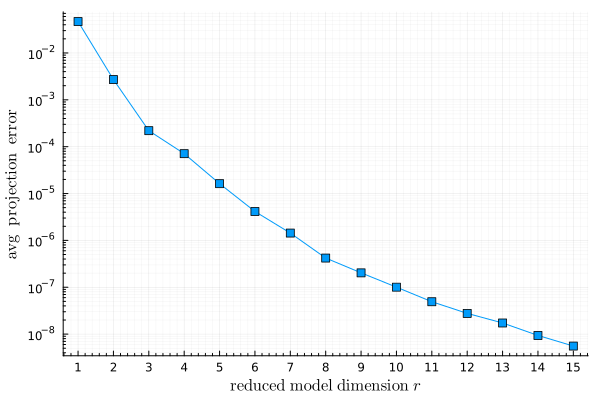

In [8]:
# Training data
mean_train_proj_err = mean(Data["train_proj_err"], dims=2)
plot(rmin:rmax, mean_train_proj_err, marker=(:rect))
plot!(yscale=:log10, majorgrid=true, minorgrid=true, legend=false)
tmp = log10.(mean_train_proj_err)
yticks!([10.0^i for i in floor(minimum(tmp))-1:ceil(maximum(tmp))+1])
xticks!(rmin:rmax)
xlabel!(L"\mathrm{reduced~model~dimension~} r")
ylabel!(L"\mathrm{avg~~projection~~error}")

#### Mean relative state error

In [9]:
DataFrame(Data["train_state_err"][:LS], :auto)

Row,x1,x2,x3,x4,x5,x6,x7,x8,x9,x10
,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64
1,0.0798797,0.0667512,0.0571799,0.0498548,0.0440789,0.0394237,0.0356022,0.0324173,0.0297264,0.0274255
2,0.00671959,0.00463278,0.0033924,0.00261728,0.00211682,0.00178506,0.0015749,0.00144118,0.00135874,0.00131093
3,0.000820674,0.00074749,0.000795702,0.000848977,0.000888812,0.000927505,0.000951034,0.000978563,0.00104585,0.00103327
4,0.000512995,0.000480801,0.000623361,0.000654866,0.000611387,0.000664969,0.000566277,0.000497825,0.000455968,0.000432258
5,0.000510335,0.000319103,0.000303335,0.000289199,0.000274836,0.000281907,0.00026542,0.000252411,0.000242292,0.000233983
6,0.000304351,0.000237153,0.000195862,0.00016393,0.000154517,0.000151956,0.000149367,0.000147361,0.000145814,0.000144698
7,0.000256868,0.000174922,0.000161322,0.000132586,0.000123303,0.000119917,0.000118141,0.000117372,0.000117291,0.000117639
8,0.000220858,0.000150683,0.000135039,0.000122564,0.000115752,0.00011293,0.000111445,0.000110959,0.000111178,0.000111863
9,0.000208635,0.000147026,0.000129554,0.000119106,0.000113766,0.00011145,0.000110166,0.000109815,0.000110152,0.000110928


In [10]:
DataFrame(Data["train_state_err"][:int], :auto)

Row,x1,x2,x3,x4,x5,x6,x7,x8,x9,x10
,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64
1,0.0797151,0.0666937,0.0571528,0.0498424,0.0440727,0.0394194,0.0355996,0.0324155,0.0297252,0.0274245
2,0.00730108,0.00488749,0.00350782,0.00267266,0.0021452,0.00180674,0.00159083,0.00145601,0.00137472,0.00132835
3,0.000779919,0.000726992,0.000808745,0.000893883,0.000963048,0.00101647,0.00105288,0.00106543,0.0010228,0.000963814
4,0.000402714,0.000469089,0.000508657,0.000488521,0.000465973,0.00044762,0.000432996,0.000421725,0.000413055,0.000405622
5,0.000302874,0.000277708,0.00024729,0.000231802,0.000222439,0.000215893,0.000210615,0.000205817,0.000201089,0.00019622
6,0.000166037,0.000137826,0.00011934,0.000109184,0.000103135,9.91521e-5,9.61955e-5,9.37278e-5,9.14732e-5,8.92946e-5
7,8.05649e-5,7.09842e-5,5.92364e-5,5.10085e-5,4.60693e-5,4.32112e-5,4.15428e-5,4.05411e-5,3.99265e-5,3.95542e-5
8,3.29773e-5,3.24909e-5,2.93551e-5,2.54821e-5,2.21759e-5,2.00362e-5,1.89123e-5,1.84826e-5,1.85024e-5,1.88223e-5
9,1.43494e-5,1.37857e-5,1.28328e-5,1.18589e-5,1.09099e-5,1.00892e-5,9.6092e-6,9.54853e-6,9.84137e-6,1.0392e-5


In [11]:
DataFrame(Data["train_state_err"][:ephec_OpInf], :auto)

Row,x1,x2,x3,x4,x5,x6,x7,x8,x9,x10
,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64
1,0.0797366,0.0667058,0.0571618,0.0498485,0.0440764,0.0394221,0.0356018,0.0324176,0.0297273,0.0274263
2,0.00732021,0.0049051,0.0035201,0.00268452,0.00215655,0.00181779,0.00160359,0.00147448,0.00141054,0.00136999
3,0.000797565,0.000741044,0.000823551,0.000904897,0.000952449,0.000997002,0.00104047,0.00107327,0.00106097,0.000988759
4,0.000432425,0.000485914,0.000513218,0.000490983,0.000470781,0.000455567,0.000444493,0.000435208,0.000425637,0.000417549
5,0.000334905,0.000299134,0.000267593,0.000252421,0.000244026,0.000237893,0.000233112,0.000228621,0.000223728,0.000218986
6,0.000213482,0.000180661,0.000162365,0.00015201,0.000145788,0.000141532,0.000138451,0.000135725,0.000132768,0.000130802
7,0.000153537,0.000137696,0.000127089,0.000119767,0.000115065,0.000111631,0.000109177,0.000107157,0.000105051,0.000104002
8,0.000137029,0.000122777,0.000115908,0.000111106,0.00010765,0.000104842,0.000102681,0.000100877,9.90306e-5,9.8092e-5
9,0.000134408,0.0001201,0.000113451,0.000108943,0.000105944,0.000103528,0.000101569,9.98619e-5,9.80466e-5,9.70778e-5


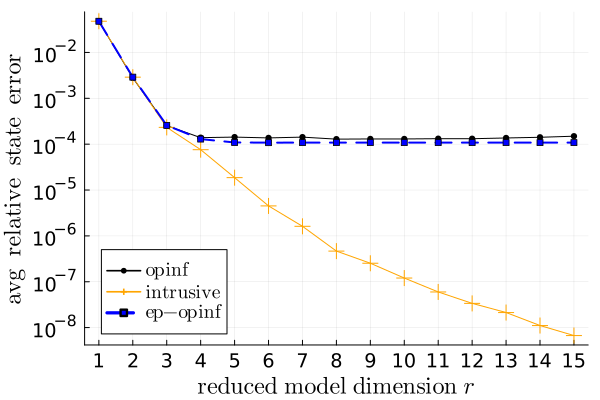

In [9]:
# Training data
c1,c2,c3,c4,c5 = palette(:default)
mean_LS_state_err = nanmean(Data["train_state_err"][:LS], dims=2)
mean_int_state_err = mean(Data["train_state_err"][:int], dims=2)
# mean_nc_state_err = mean(Data["train_state_err"][:nc_OpInf], dims=2)
mean_ephec_state_err = mean(Data["train_state_err"][:ephec_OpInf], dims=2)
# mean_epsic_state_err = mean(Data["train_state_err"][:epsic_OpInf], dims=2)
# mean_epuc_state_err = nanmean(Data["train_state_err"][:epuc_OpInf], dims=2)

plot(rmin:rmax, mean_LS_state_err, c=:black, marker=(:circle, 3.5), label=L"\mathrm{opinf}")
plot!(rmin:rmax, mean_int_state_err, c=:orange, marker=(:cross, 8), label=L"\mathrm{intrusive}")
# plot!(rmin:rmax, mean_nc_state_err, marker=(:circle), ls=:dash, label=L"\mathrm{nc:opinf}")
plot!(rmin:rmax, mean_ephec_state_err, c=:blue, marker=(:rect, 3), ls=:dash, lw=2, label=L"\mathrm{ep}\rm{-}\mathrm{opinf}")
# plot!(rmin:rmax, mean_epsic_state_err, marker=(:dtriangle, 5), ls=:dot, label=L"\mathrm{epsic}:\mathrm{opinf}")
# plot!(rmin:rmax, mean_epuc_state_err, c=:blue, marker=(:rect, 3), ls=:dash, lw=2, label=L"\mathrm{epuc}\rm{-}\mathrm{opinf}")
plot!(yscale=:log10, majorgrid=true, legend=:bottomleft)
tmp = log10.(mean_int_state_err)
yticks!([10.0^i for i in floor(minimum(tmp))-1:ceil(maximum(tmp))+1])
xticks!(rmin:rmax)
xlabel!(L"\mathrm{reduced~model~dimension~} r")
ylabel!(L"\mathrm{avg~~relative~~state~~error}")
plot!(guidefontsize=16, tickfontsize=13,  legendfontsize=13)

#### Total Energy

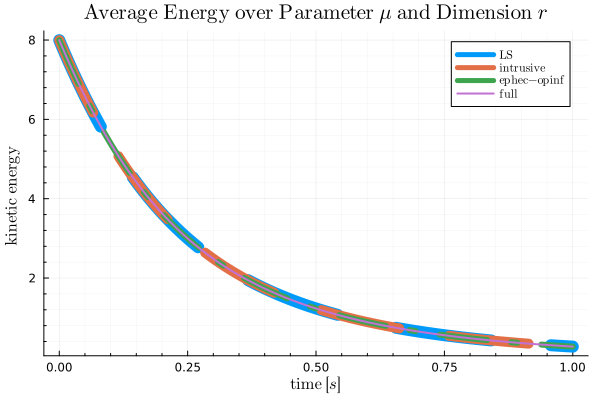

In [21]:
# Training data
mean_LS_En_tr = mean(Data["train_En"][:LS])
mean_int_En_tr = mean(Data["train_En"][:int])
mean_ephec_En_tr = mean(Data["train_En"][:ephec_OpInf])
# mean_epsic_En_tr = mean(Data["train_En"][:epsic_OpInf])
# mean_epuc_En_tr = mean(Data["train_En"][:epuc_OpInf])
mean_fom_En_tr = mean(Data["train_En"][:fom])

plot(burger.t, mean_LS_En_tr, lw=12, ls=:dash, label=L"\mathrm{LS}")
plot!(burger.t, mean_int_En_tr, lw=10, ls=:dash, label=L"\mathrm{intrusive}")
plot!(burger.t, mean_ephec_En_tr, lw=6, ls=:dashdot, label=L"\mathrm{ephec}\rm{-}\mathrm{opinf}")
# plot!(burger.t, mean_epsic_En_tr, lw=4, ls=:dashdotdot, label=L"\mathrm{epsic:opinf}")
# plot!(burger.t, mean_epuc_En_tr, lw=6, ls=:dashdot, label=L"\mathrm{ephec}\rm{-}\mathrm{opinf}")
plot!(burger.t, mean_fom_En_tr, lw=2, label=L"\mathrm{full}")
plot!(majorgrid=true, minorgrid=true, legend=:topright)
xlabel!(L"\mathrm{time}~[s]")
ylabel!(L"\mathrm{kinetic~energy~}")
title!(L"\mathrm{Average~Energy~over~Parameter}~\mu \mathrm{~and~Dimension~} r")

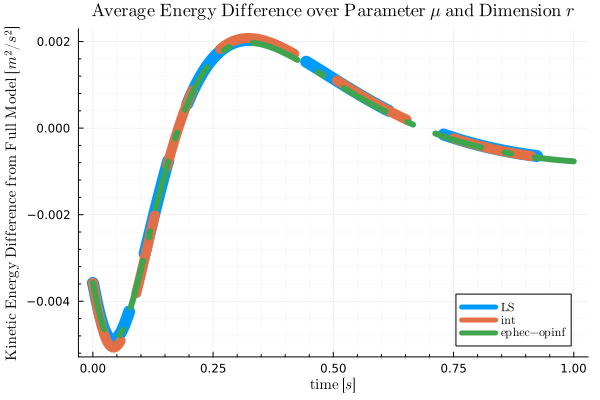

In [22]:
plot(burger.t, mean_LS_En_tr - mean_fom_En_tr, lw=12, ls=:dash, label=L"\mathrm{LS}")
plot!(burger.t, mean_int_En_tr - mean_fom_En_tr, lw=10, ls=:dash, label=L"\mathrm{int}")
plot!(burger.t, mean_ephec_En_tr - mean_fom_En_tr, lw=6, ls=:dashdot, label=L"\mathrm{ephec}\rm{-}\mathrm{opinf}")
# plot!(burger.t, mean_epsic_En_tr - mean_fom_En_tr, lw=4, ls=:dashdotdot, label=L"\mathrm{epsic}\rm{-}\mathrm{opinf}")
# plot!(burger.t, mean_epuc_En_tr - mean_fom_En_tr, lw=6, ls=:dashdot, label=L"\mathrm{epuc}\rm{-}\mathrm{opinf}")
plot!(majorgrid=true, minorgrid=true, legend=:bottomright)
xlabel!(L"\mathrm{time}~[s]")
ylabel!(L"\mathrm{Kinetic~Energy~Difference~from~Full~Model}~[m^2/s^2]", fontsize=(8))
title!(L"\mathrm{Average~Energy~Difference~over~Parameter}~\mu \mathrm{~and~Dimension~} r", titlefont = font(12))
plot!(guidefontsize=10)

#### Constraint Residual 

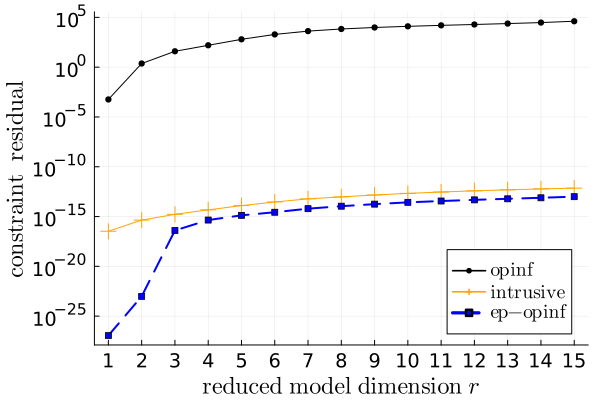

In [23]:
mean_LS_CR_tr = mean(Data["train_CR"][:LS], dims=2)
mean_int_CR_tr = mean(Data["train_CR"][:int], dims=2)
mean_ephec_CR_tr = mean(Data["train_CR"][:ephec_OpInf], dims=2)
# mean_epsic_CR_tr = mean(Data["train_CR"][:epsic_OpInf], dims=2)
# mean_epuc_CR_tr = mean(Data["train_CR"][:epuc_OpInf], dims=2)
mean_fom_CR_tr = mean(Data["train_CR"][:fom])

plot(rmin:rmax, mean_LS_CR_tr, marker=(:circle, 3.5), c=:black, label=L"\mathrm{opinf}")
plot!(rmin:rmax, mean_int_CR_tr, c=:orange, marker=(:cross, 8), label=L"\mathrm{intrusive}")
plot!(rmin:rmax, mean_ephec_CR_tr, c=:blue, marker=(:rect, 3), lw=2, ls=:dash, label=L"\mathrm{ep}\rm{-}\mathrm{opinf}")
# plot!(rmin:rmax, mean_epsic_CR_tr, marker=(:dtriangle, 5), ls=:dot, label=L"\mathrm{epsic}:\mathrm{opinf}")
# plot!(rmin:rmax, mean_epuc_CR_tr, c=:blue, marker=(:rect, 3), lw=2, ls=:dash, label=L"\mathrm{epuc}\rm{-}\mathrm{opinf}")
plot!(yscale=:log10, majorgrid=true, legend=:bottomright, minorgridalpha=0.03)
yticks!(10.0 .^ [-25, -20, -15, -10, -5, 0, 5])
xticks!(1:15)
xlabel!(L"\mathrm{reduced~model~dimension}~r")
ylabel!(L"\mathrm{constraint~~residual}")
plot!(guidefontsize=16, tickfontsize=13,  legendfontsize=13)

#### Momentum 

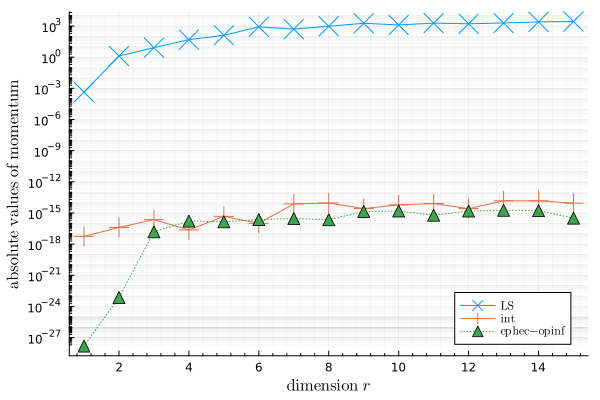

In [30]:
mean_LS_mmt_tr    = abs.(mean(Data["train_mmt"][:LS], dims=2))
mean_int_mmt_tr   = abs.(mean(Data["train_mmt"][:int], dims=2))
mean_ephec_mmt_tr = abs.(mean(Data["train_mmt"][:ephec_OpInf], dims=2))
# mean_epsic_mmt_tr = abs.(mean(Data["train_mmt"][:epsic_OpInf], dims=2))
# mean_epuc_mmt_tr = abs.(mean(Data["train_mmt"][:epuc_OpInf], dims=2))
mean_fom_mmt_tr   = abs.(mean(Data["train_mmt"][:fom]))

plot(rmin:rmax, mean_LS_mmt_tr, marker=(:xcross, 10), label=L"\mathrm{LS}")
plot!(rmin:rmax, mean_int_mmt_tr, marker=(:cross, 10), label=L"\mathrm{int}")
plot!(rmin:rmax, mean_ephec_mmt_tr, marker=(:utriangle, 6), ls=:dot, label=L"\mathrm{ephec}\rm{-}\mathrm{opinf}")
# plot!(rmin:rmax, mean_epsic_mmt_tr, marker=(:dtriangle, 5), ls=:dot, label=L"\mathrm{epsic}\rm{-}\mathrm{opinf}")
# plot!(rmin:rmax, mean_epuc_mmt_tr, marker=(:utriangle, 6), ls=:dot, label=L"\mathrm{ephec}\rm{-}\mathrm{opinf}")
plot!(yscale=:log10, majorgrid=true, minorgrid=true, legend=:bottomright)
yticks!(10.0 .^ [-27, -24, -21, -18, -15, -12, -9, -6, -3, 0, 3, 6])
xlabel!(L"\mathrm{dimension}~r")
ylabel!(L"\mathrm{absolute~values~of~momentum}")


#### Constraint Violation

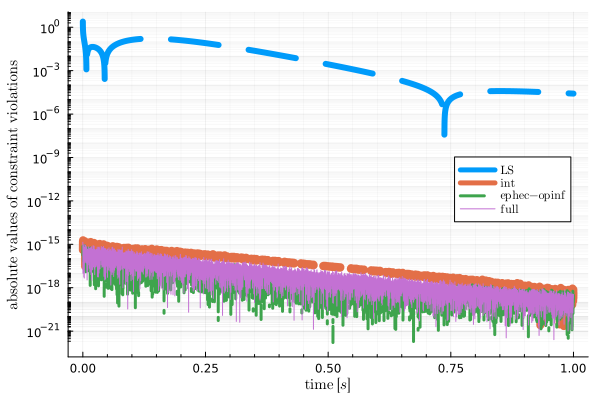

In [31]:
# Training data
mean_LS_CV_tr    = abs.(mean(Data["train_CV"][:LS]))
mean_int_CV_tr   = abs.(mean(Data["train_CV"][:int]))
mean_ephec_CV_tr = abs.(mean(Data["train_CV"][:ephec_OpInf]))
# mean_epsic_CV_tr = abs.(mean(Data["train_CV"][:epsic_OpInf]))
# mean_epuc_CV_tr = abs.(mean(Data["train_CV"][:epuc_OpInf]))
mean_fom_CV_tr   = abs.(mean(Data["train_CV"][:fom]))

plot(burger.t, mean_LS_CV_tr, lw=6, ls=:dash, label=L"\mathrm{LS}")
plot!(burger.t, mean_int_CV_tr, lw=8, ls=:dash, label=L"\mathrm{int}")
plot!(burger.t, mean_ephec_CV_tr, lw=3, ls=:dashdot, label=L"\mathrm{ephec}\rm{-}\mathrm{opinf}")
# plot!(burger.t, mean_epsic_CV_tr, lw=3, ls=:dashdotdot, label=L"\mathrm{epsic}\rm{-}\mathrm{opinf}")
# plot!(burger.t, mean_epuc_CV_tr, lw=3, ls=:dashdot, label=L"\mathrm{epuc}\rm{-}\mathrm{opinf}")
plot!(burger.t, mean_fom_CV_tr, lw=1, label=L"\mathrm{full}")
plot!(yscale=:log10, majorgrid=true, minorgrid=true, legend=:right)
yticks!(10.0 .^ [-24, -21, -18, -15, -12, -9, -6, -3, 0])
xlabel!(L"\mathrm{time}~[s]")
ylabel!(L"\mathrm{absolute~values~of~constraint~violations}")
plot!(guidefontsize=10)